# SSD Evaluation Tutorial

This is a brief tutorial that explains how compute the average precisions for any trained SSD model using the `Evaluator` class. The `Evaluator` computes the average precisions according to the Pascal VOC pre-2010 or post-2010 detection evaluation algorithms. You can find details about these computation methods [here](http://host.robots.ox.ac.uk/pascal/VOC/voc2012/htmldoc/devkit_doc.html#sec:ap).

As an example we'll evaluate an SSD300 on the Pascal VOC 2007 `test` dataset, but note that the `Evaluator` works for any SSD model and any dataset that is compatible with the `DataGenerator`. If you would like to run the evaluation on a different model and/or dataset, the procedure is analogous to what is shown below, you just have to build the appropriate model and load the relevant dataset.

Note: I that in case you would like to evaluate a model on MS COCO, I would recommend to follow the [MS COCO evaluation notebook](https://github.com/pierluigiferrari/ssd_keras/blob/master/ssd300_evaluation_COCO.ipynb) instead, because it can produce the results format required by the MS COCO evaluation server and uses the official MS COCO evaluation code, which computes the mAP slightly differently from the Pascal VOC method.

Note: In case you want to evaluate any of the provided trained models, make sure that you build the respective model with the correct set of scaling factors to reproduce the official results. The models that were trained on MS COCO and fine-tuned on Pascal VOC require the MS COCO scaling factors, not the Pascal VOC scaling factors.

In [1]:
from tensorflow.keras import backend as K
from tensorflow.keras.models import load_model
from tensorflow.keras.optimizers import Adam
from scipy.misc import imread
import numpy as np
from matplotlib import pyplot as plt

from models.keras_ssd7 import build_model
from keras_loss_function.keras_ssd_loss import SSDLoss
from keras_layers.keras_layer_AnchorBoxes import AnchorBoxes
from keras_layers.keras_layer_DecodeDetections import DecodeDetections
from keras_layers.keras_layer_DecodeDetectionsFast import DecodeDetectionsFast
from keras_layers.keras_layer_L2Normalization import L2Normalization
from data_generator.object_detection_2d_data_generator import DataGenerator
from eval_utils.average_precision_evaluator import Evaluator

from ssd_encoder_decoder.ssd_output_decoder import decode_detections, decode_detections_fast


from tensorflow.keras.models import Model


%matplotlib inline

Using TensorFlow backend.


In [2]:
# Set a few configuration parameters.
img_height = 300
img_width = 480
n_classes = 5
model_mode = 'training'

## 1. Load a trained SSD

Either load a trained model or build a model and load trained weights into it. Since the HDF5 files I'm providing contain only the weights for the various SSD versions, not the complete models, you'll have to go with the latter option when using this implementation for the first time. You can then of course save the model and next time load the full model directly, without having to build it.

You can find the download links to all the trained model weights in the README.

### 1.1. Build the model and load trained weights into it

In [3]:
'''
# 1: Build the Keras model

K.clear_session() # Clear previous models from memory.

model = ssd_300(image_size=(img_height, img_width, 3),
                n_classes=n_classes,
                mode=model_mode,
                l2_regularization=0.0005,
                scales=[0.1, 0.2, 0.37, 0.54, 0.71, 0.88, 1.05], # The scales for MS COCO [0.07, 0.15, 0.33, 0.51, 0.69, 0.87, 1.05]
                aspect_ratios_per_layer=[[1.0, 2.0, 0.5],
                                         [1.0, 2.0, 0.5, 3.0, 1.0/3.0],
                                         [1.0, 2.0, 0.5, 3.0, 1.0/3.0],
                                         [1.0, 2.0, 0.5, 3.0, 1.0/3.0],
                                         [1.0, 2.0, 0.5],
                                         [1.0, 2.0, 0.5]],
                two_boxes_for_ar1=True,
                steps=[8, 16, 32, 64, 100, 300],
                offsets=[0.5, 0.5, 0.5, 0.5, 0.5, 0.5],
                clip_boxes=False,
                variances=[0.1, 0.1, 0.2, 0.2],
                normalize_coords=True,
                subtract_mean=[123, 117, 104],
                swap_channels=[2, 1, 0],
                confidence_thresh=0.01,
                iou_threshold=0.45,
                top_k=200,
                nms_max_output_size=400)

# 2: Load the trained weights into the model.

# TODO: Set the path of the trained weights.
weights_path = 'path/to/trained/weights/VGG_VOC0712_SSD_300x300_ft_iter_120000.h5'

model.load_weights(weights_path, by_name=True)

# 3: Compile the model so that Keras won't complain the next time you load it.

adam = Adam(lr=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-08, decay=0.0)

ssd_loss = SSDLoss(neg_pos_ratio=3, alpha=1.0)

model.compile(optimizer=adam, loss=ssd_loss.compute_loss)
'''

"\n# 1: Build the Keras model\n\nK.clear_session() # Clear previous models from memory.\n\nmodel = ssd_300(image_size=(img_height, img_width, 3),\n                n_classes=n_classes,\n                mode=model_mode,\n                l2_regularization=0.0005,\n                scales=[0.1, 0.2, 0.37, 0.54, 0.71, 0.88, 1.05], # The scales for MS COCO [0.07, 0.15, 0.33, 0.51, 0.69, 0.87, 1.05]\n                aspect_ratios_per_layer=[[1.0, 2.0, 0.5],\n                                         [1.0, 2.0, 0.5, 3.0, 1.0/3.0],\n                                         [1.0, 2.0, 0.5, 3.0, 1.0/3.0],\n                                         [1.0, 2.0, 0.5, 3.0, 1.0/3.0],\n                                         [1.0, 2.0, 0.5],\n                                         [1.0, 2.0, 0.5]],\n                two_boxes_for_ar1=True,\n                steps=[8, 16, 32, 64, 100, 300],\n                offsets=[0.5, 0.5, 0.5, 0.5, 0.5, 0.5],\n                clip_boxes=False,\n                variance

Or

### 1.2. Load a trained model

We set `model_mode` to 'inference' above, so the evaluator expects that you load a model that was built in 'inference' mode. If you're loading a model that was built in 'training' mode, change the `model_mode` parameter accordingly.

In [4]:
# TODO: Set the path to the `.h5` file of the model to be loaded.
model_path = './striped_pruned_model2312_0215.h5'

# We need to create an SSDLoss object in order to pass that to the model loader.
ssd_loss = SSDLoss(neg_pos_ratio=3, alpha=1.0)

#K.clear_session() # Clear previous models from memory.

model = load_model(model_path, custom_objects={'AnchorBoxes': AnchorBoxes,
                                               'L2Normalization': L2Normalization,
                                               'DecodeDetections': DecodeDetections,
                                               'compute_loss': ssd_loss.compute_loss})

''' 
# This part didn't work
m_input = model.input
m_output = model.output
decoded_predictions = DecodeDetections(confidence_thresh=0.5,
                                        iou_threshold=0.45,
                                        top_k=200,
                                        nms_max_output_size=400,
                                        coords='centroids',
                                        normalize_coords=True,
                                        img_height=img_height,
                                        img_width=img_width,
                                        name='decoded_predictions')(m_output)
model = Model(inputs=m_input, outputs=decoded_predictions)
'''

Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor


" \n# This part didn't work\nm_input = model.input\nm_output = model.output\ndecoded_predictions = DecodeDetections(confidence_thresh=0.5,\n                                        iou_threshold=0.45,\n                                        top_k=200,\n                                        nms_max_output_size=400,\n                                        coords='centroids',\n                                        normalize_coords=True,\n                                        img_height=img_height,\n                                        img_width=img_width,\n                                        name='decoded_predictions')(m_output)\nmodel = Model(inputs=m_input, outputs=decoded_predictions)\n"

## 2. Create a data generator for the evaluation dataset

Instantiate a `DataGenerator` that will serve the evaluation dataset during the prediction phase.

In [5]:
'''
dataset = DataGenerator()

# TODO: Set the paths to the dataset here.
Pascal_VOC_dataset_images_dir = '../ssd_pruning/evaluation_datasets_sample_1/Images/'
Pascal_VOC_dataset_annotations_dir = '../ssd_pruning/evaluation_datasets_sample_1/Annotations/'
Pascal_VOC_dataset_image_set_filename = '../ssd_pruning/evaluation_datasets_sample_1/train.txt'

# The XML parser needs to now what object class names to look for and in which order to map them to integers.
classes = ['background',
           'car', 'truck', 'pedestrian', 'bicyclist',
           'light']

dataset.parse_xml(images_dirs=[Pascal_VOC_dataset_images_dir],
                  image_set_filenames=[Pascal_VOC_dataset_image_set_filename],
                  annotations_dirs=[Pascal_VOC_dataset_annotations_dir],
                  classes=classes,
                  include_classes='all',
                  exclude_truncated=False,
                  exclude_difficult=False,
                  ret=False)
'''

"\ndataset = DataGenerator()\n\n# TODO: Set the paths to the dataset here.\nPascal_VOC_dataset_images_dir = '../ssd_pruning/evaluation_datasets_sample_1/Images/'\nPascal_VOC_dataset_annotations_dir = '../ssd_pruning/evaluation_datasets_sample_1/Annotations/'\nPascal_VOC_dataset_image_set_filename = '../ssd_pruning/evaluation_datasets_sample_1/train.txt'\n\n# The XML parser needs to now what object class names to look for and in which order to map them to integers.\nclasses = ['background',\n           'car', 'truck', 'pedestrian', 'bicyclist',\n           'light']\n\ndataset.parse_xml(images_dirs=[Pascal_VOC_dataset_images_dir],\n                  image_set_filenames=[Pascal_VOC_dataset_image_set_filename],\n                  annotations_dirs=[Pascal_VOC_dataset_annotations_dir],\n                  classes=classes,\n                  include_classes='all',\n                  exclude_truncated=False,\n                  exclude_difficult=False,\n                  ret=False)\n"

### 2.1 Custom data generator for SSD7 

In [6]:
#'''
# 1: Instantiate two `DataGenerator` objects: One for training, one for validation.

# Optional: If you have enough memory, consider loading the images into memory for the reasons explained above.

eval_dataset = DataGenerator()

# 2: Parse the image and label lists for the training and validation datasets.

# TODO: Set the paths to your dataset here.

# Images
images_dir = '../ssd_pruning/evaluation_datasets_100/'
#images_dir = '../ssd_pruning/udacity_driving_datasets/'


# Ground truth
#train_labels_filename = '../ssd_pruning/udacity_driving_datasets/labels_train_car.csv'
val_labels_filename   = '../ssd_pruning/evaluation_datasets_100/labels_eval_car.csv'
#val_labels_filename   = '../ssd_pruning/udacity_driving_datasets/labels_val_car.csv'

eval_dataset.parse_csv(images_dir=images_dir,
                        labels_filename=val_labels_filename,
                        input_format=['image_name', 'xmin', 'xmax', 'ymin', 'ymax', 'class_id'], # This is the order of the first six columns in the CSV file that contains the labels for your dataset. If your labels are in XML format, maybe the XML parser will be helpful, check the documentation.
                        include_classes='all')
#'''

## 3. Run the evaluation

Now that we have instantiated a model and a data generator to serve the dataset, we can set up the evaluator and run the evaluation.

The evaluator is quite flexible: It can compute the average precisions according to the Pascal VOC pre-2010 algorithm, which samples 11 equidistant points of the precision-recall curves, or according to the Pascal VOC post-2010 algorithm, which integrates numerically over the entire precision-recall curves instead of sampling a few individual points. You could also change the number of sampled recall points or the required IoU overlap for a prediction to be considered a true positive, among other things. Check out the `Evaluator`'s documentation for details on all the arguments.

In its default settings, the evaluator's algorithm is identical to the official Pascal VOC pre-2010 Matlab detection evaluation algorithm, so you don't really need to tweak anything unless you want to.

The evaluator roughly performs the following steps: It runs predictions over the entire given dataset, then it matches these predictions to the ground truth boxes, then it computes the precision-recall curves for each class, then it samples 11 equidistant points from these precision-recall curves to compute the average precision for each class, and finally it computes the mean average precision over all classes.

In [7]:
evaluator = Evaluator(model=model,
                      n_classes=n_classes,
                      data_generator=eval_dataset,
                      model_mode=model_mode)

results = evaluator(img_height=img_height,
                    img_width=img_width,
                    batch_size=1,
                    data_generator_mode='resize',
                    round_confidences=False,
                    matching_iou_threshold=0.5,
                    border_pixels='include',
                    sorting_algorithm='quicksort',
                    average_precision_mode='sample',
                    num_recall_points=11,
                    ignore_neutral_boxes=True,
                    return_precisions=True,
                    return_recalls=True,
                    return_average_precisions=True,
                    verbose=True)

mean_average_precision, average_precisions, precisions, recalls = results

classes = ['background',
           'car', 'truck', 'pedestrian', 'bicyclist',
           'light']

Number of images in the evaluation dataset: 30

Matching predictions to ground truth, class 5/5.: 100%|██████████| 3085/3085 [00:00<00:00, 26732.37it/s]
printing class id 1
Computing precisions and recalls, class 1/5
printing class id 2
Computing precisions and recalls, class 2/5
printing class id 3
Computing precisions and recalls, class 3/5
printing class id 4
Computing precisions and recalls, class 4/5
printing class id 5
Computing precisions and recalls, class 5/5
Computing average precision, class 1/5
printing individual precisions -->  0.8780487804878049
printing individual precisions -->  0.8780487804878049
printing individual precisions -->  0.8666666666666667
printing individual precisions -->  0.7530864197530864
printing individual precisions -->  0.5934959349593496
printing individual precisions -->  0.5652173913043478
printing individual precisions -->  0.17165354330708663
printing individual precisions -->  0.0
printing individual precisions -->  0.0
printing individual pr

## 4. Visualize the results

Let's take a look:

In [ ]:
print(average_precisions)

In [8]:
for i in range(1, len(average_precisions)):
    print("{:<14}{:<6}{}".format(classes[i], 'AP', round(average_precisions[i], 3)))
print()
print("{:<14}{:<6}{}".format('','mAP', round(mean_average_precision, 3)))

car           AP    0.428
truck         AP    0.684
pedestrian    AP    0.0
bicyclist     AP    0.0
light         AP    0.118

              mAP   0.246


In [ ]:
m = max((n_classes + 1) // 2, 2)
n = 2

fig, cells = plt.subplots(m, n, figsize=(n*8,m*8))
for i in range(m):
    for j in range(n):
        if n*i+j+1 > n_classes: break
        cells[i, j].plot(recalls[n*i+j+1], precisions[n*i+j+1], color='blue', linewidth=1.0)
        cells[i, j].set_xlabel('recall', fontsize=14)
        cells[i, j].set_ylabel('precision', fontsize=14)
        cells[i, j].grid(True)
        cells[i, j].set_xticks(np.linspace(0,1,11))
        cells[i, j].set_yticks(np.linspace(0,1,11))
        cells[i, j].set_title("{}, AP: {:.3f}".format(classes[n*i+j+1], average_precisions[n*i+j+1]), fontsize=16)

## 5. Advanced use

`Evaluator` objects maintain copies of all relevant intermediate results like predictions, precisions and recalls, etc., so in case you want to experiment with different parameters, e.g. different IoU overlaps, there is no need to compute the predictions all over again every time you make a change to a parameter. Instead, you can only update the computation from the point that is affected onwards.

The evaluator's `__call__()` method is just a convenience wrapper that executes its other methods in the correct order. You could just call any of these other methods individually as shown below (but you have to make sure to call them in the correct order).

Note that the example below uses the same evaluator object as above. Say you wanted to compute the Pascal VOC post-2010 'integrate' version of the average precisions instead of the pre-2010 version computed above. The evaluator object still has an internal copy of all the predictions, and since computing the predictions makes up the vast majority of the overall computation time and since the predictions aren't affected by changing the average precision computation mode, we skip computing the predictions again and instead only compute the steps that come after the prediction phase of the evaluation. We could even skip the matching part, since it isn't affected by changing the average precision mode either. In fact, we would only have to call `compute_average_precisions()` `compute_mean_average_precision()` again, but for the sake of illustration we'll re-do the other computations, too.

In [ ]:
evaluator.get_num_gt_per_class(ignore_neutral_boxes=True,
                               verbose=False,
                               ret=False)

evaluator.match_predictions(ignore_neutral_boxes=True,
                            matching_iou_threshold=0.5,
                            border_pixels='include',
                            sorting_algorithm='quicksort',
                            verbose=True,
                            ret=False)

precisions, recalls = evaluator.compute_precision_recall(verbose=True, ret=True)

average_precisions = evaluator.compute_average_precisions(mode='integrate',
                                                          num_recall_points=11,
                                                          verbose=True,
                                                          ret=True)

mean_average_precision = evaluator.compute_mean_average_precision(ret=True)

In [ ]:
for i in range(1, len(average_precisions)):
    print("{:<14}{:<6}{}".format(classes[i], 'AP', round(average_precisions[i], 3)))
print()
print("{:<14}{:<6}{}".format('','mAP', round(mean_average_precision, 3)))

### Inferencing the images in Evaluation folder

In [9]:
predict_generator = eval_dataset.generate(batch_size=1,
                                         shuffle=True,
                                         transformations=[],
                                         label_encoder=None,
                                         returns={'processed_images',
                                                  'processed_labels',
                                                  'filenames'},
                                         keep_images_without_gt=False)

In [10]:
for x in range(30):
  # 2: Generate samples
  batch_images, batch_labels, batch_filenames = next(predict_generator)
  i = 0 # Which batch item to look at
  #print("Image:", batch_filenames[i])
  #print()
  #print("Ground truth boxes:\n")
  #print(batch_labels[i])
  y_pred = model.predict(batch_images)

Image: ../ssd_pruning/evaluation_datasets_100/1478899159823020309.jpg

Ground truth boxes:

[[  1  80 151 101 165]
 [  1 141 145 159 164]
 [  2 150 135 184 168]]
Predicted boxes:

   class   conf xmin   ymin   xmax   ymax
[[  1.     1.   140.9  145.56 181.5  170.71]
 [  1.     0.57 139.3  148.12 161.78 164.51]
 [  2.     0.98 148.25 137.77 176.92 167.82]
 [  2.     0.9  156.13 128.41 182.56 174.64]
 [  2.     0.75 133.73 135.11 187.59 172.25]]
Image: ../ssd_pruning/evaluation_datasets_100/1478899171248947671.jpg

Ground truth boxes:

[[  1  75 144  98 158]
 [  1 145 136 154 144]
 [  1 152 133 159 139]
 [  1 168 142 178 160]
 [  1 170 142 179 157]
 [  2 176 130 203 163]]
Predicted boxes:

   class   conf xmin   ymin   xmax   ymax
[[  1.     0.81   2.87 125.19  55.18 198.12]
 [  1.     0.66  73.75 142.2   98.35 157.67]]
Image: ../ssd_pruning/evaluation_datasets_100/1478899114120175165.jpg

Ground truth boxes:

[[  1  90 142 133 182]
 [  1 131 142 153 172]
 [  1 221 142 244 159]
 [  2 186

Predicted boxes:

   class   conf xmin   ymin   xmax   ymax
[[  1.     0.98 157.49 140.1  228.21 212.49]
 [  1.     0.96 410.05 143.99 473.41 175.1 ]
 [  1.     0.64 233.8  151.48 253.91 167.56]
 [  2.     0.69   3.41  94.44 146.29 259.5 ]
 [  5.     0.87 330.44  72.84 347.27 111.9 ]]
Image: ../ssd_pruning/evaluation_datasets_100/1478899068416446329.jpg

Ground truth boxes:

[[  1 178 157 193 169]
 [  1 199 154 210 167]
 [  1 239 155 266 166]
 [  1 352 135 445 194]
 [  5 193 128 199 138]
 [  5 240 128 248 142]]
Predicted boxes:

   class   conf xmin   ymin   xmax   ymax
[[  1.     1.   354.88 137.47 436.89 189.74]]
Image: ../ssd_pruning/evaluation_datasets_100/1478899308358238826.jpg

Ground truth boxes:

[[  1   0  94 174 276]
 [  1 174 142 220 214]
 [  1 237 155 252 167]
 [  1 407 155 427 176]
 [  1 429 152 460 178]
 [  1 457 143 479 178]
 [  3 340 148 347 167]
 [  3 355 146 363 169]
 [  5 162 119 171 140]
 [  5 224  99 231 113]
 [  5 248 121 256 137]
 [  5 331  77 346 109]]
Predicte

/home/mohan/mlp/git/mltf114_pip2/lib/python3.6/site-packages/ipykernel_launcher.py:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Image: ../ssd_pruning/evaluation_datasets_100/1478899342635975102.jpg

Ground truth boxes:

[[  1 177 146 231 189]
 [  1 222 119 363 232]
 [  1 367 145 412 160]
 [  1 372 145 413 163]
 [  3 453 121 468 160]
 [  5 173 127 177 136]]
Predicted boxes:

   class   conf xmin   ymin   xmax   ymax
[[  1.     1.   181.49 149.38 233.27 188.48]
 [  1.     0.99 232.4  114.34 354.24 212.49]
 [  1.     0.62 390.73 145.44 416.71 161.75]]
Image: ../ssd_pruning/evaluation_datasets_100/1478899136971638253.jpg

Ground truth boxes:

[[  1  99 147 124 166]
 [  1 214 149 231 161]
 [  1 232 132 264 168]
 [  1 258 143 279 162]
 [  1 293 146 308 160]
 [  1 375 137 427 155]
 [  1 399 144 446 159]]
Predicted boxes:

   class   conf xmin   ymin   xmax   ymax
[[  1.     0.94 257.63 144.07 276.94 161.27]
 [  1.     0.88  -0.82 145.65  48.1  185.4 ]
 [  1.     0.83 101.66 149.01 122.87 164.69]
 [  1.     0.81 232.47 147.26 260.66 167.22]
 [  2.     0.54 229.9  135.52 269.61 166.79]]
Image: ../ssd_pruning/evaluation_

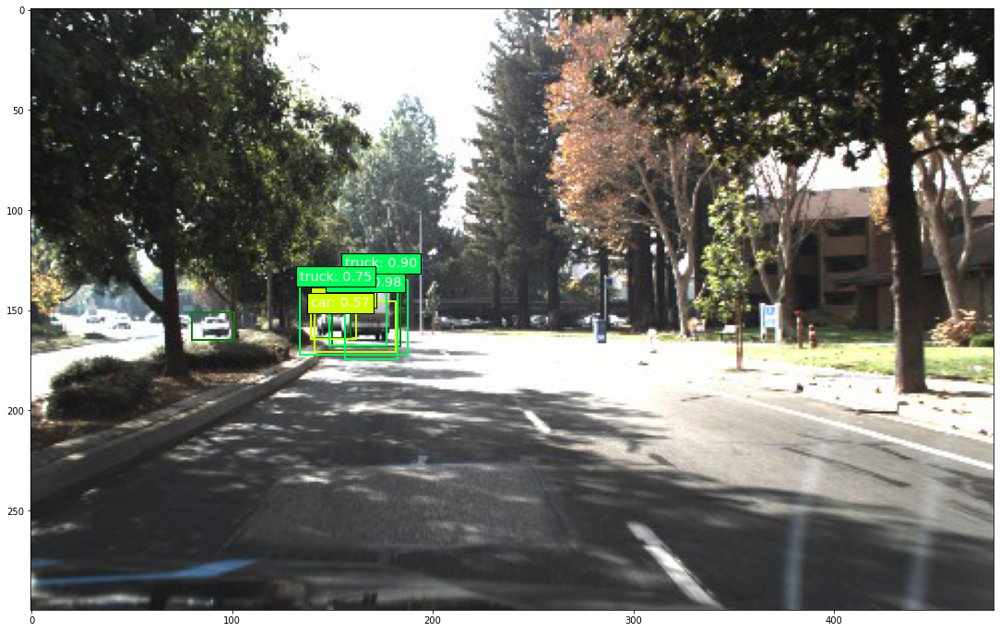

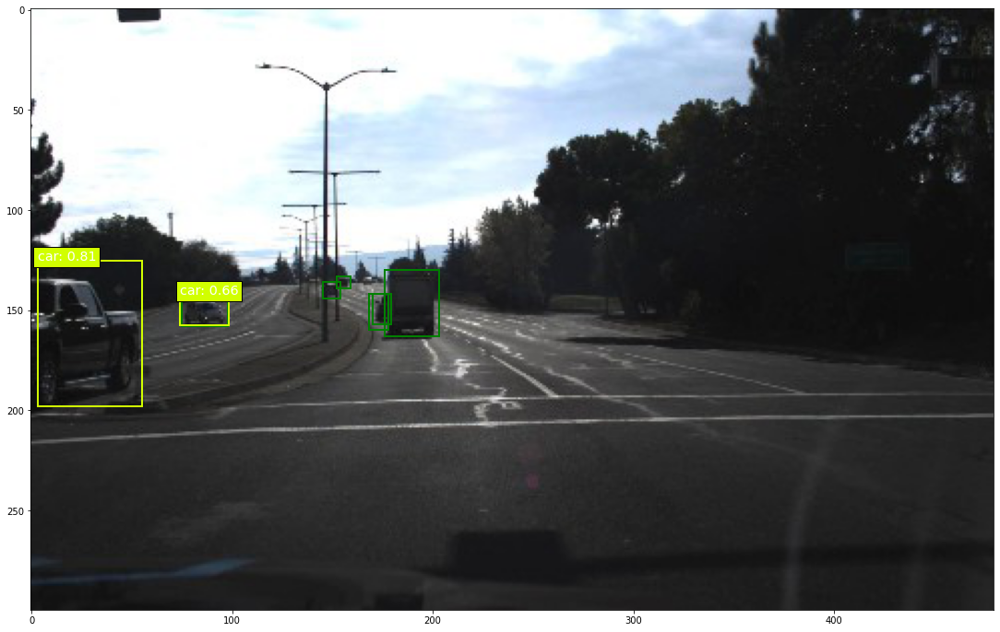

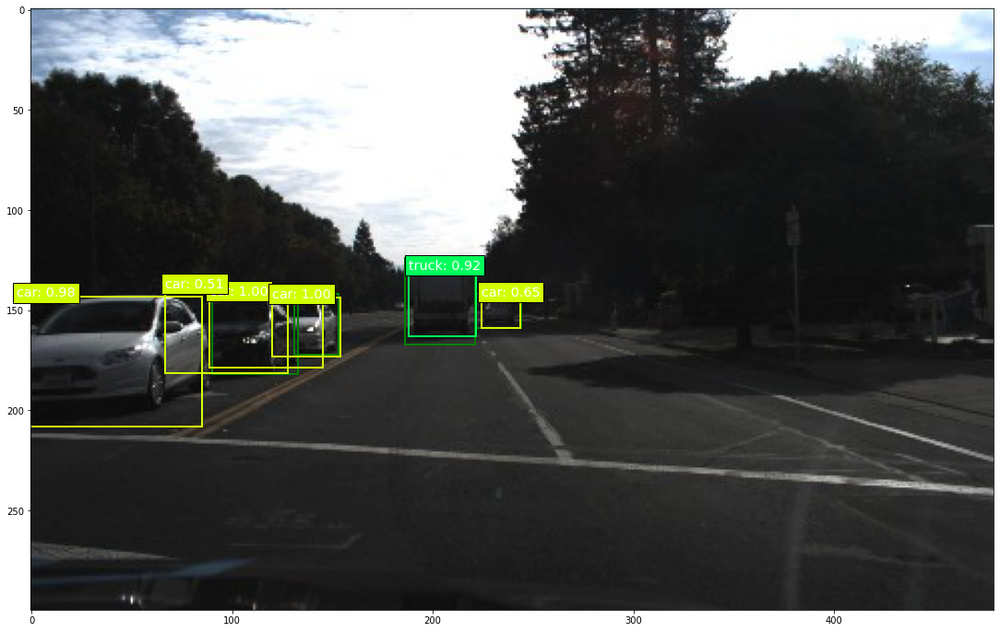

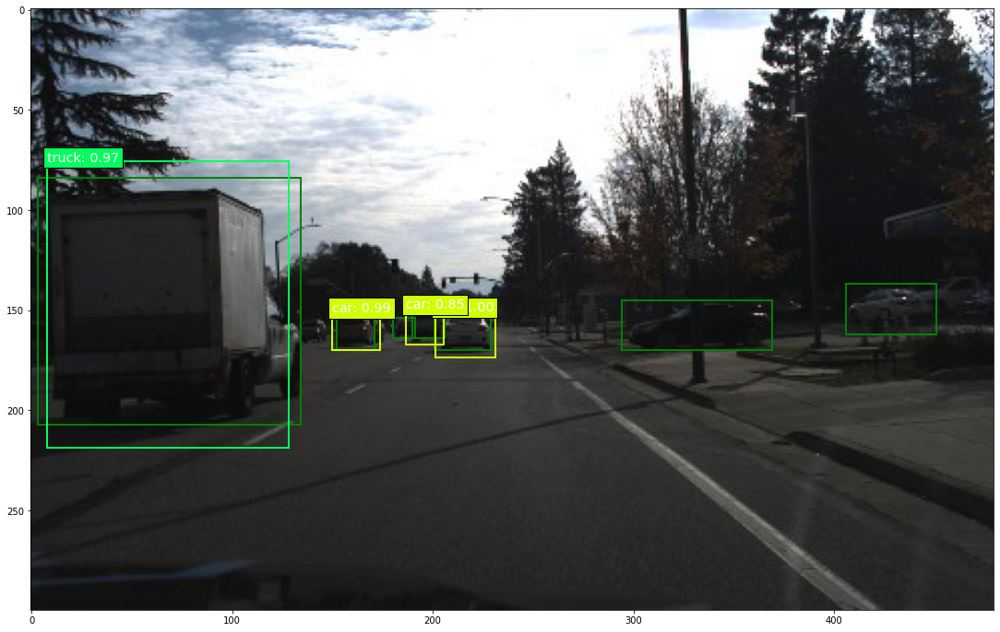

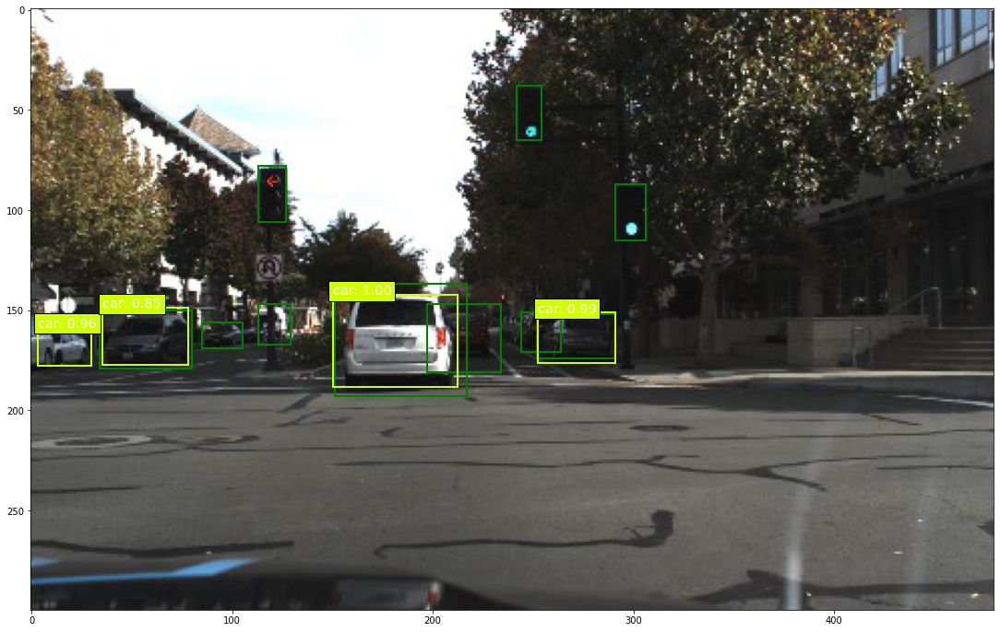

...

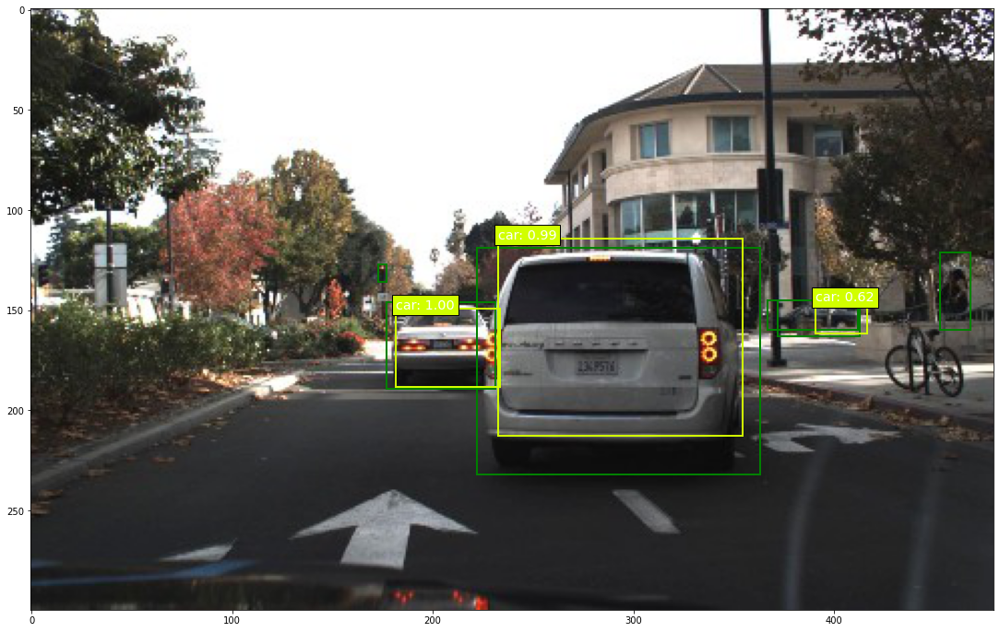

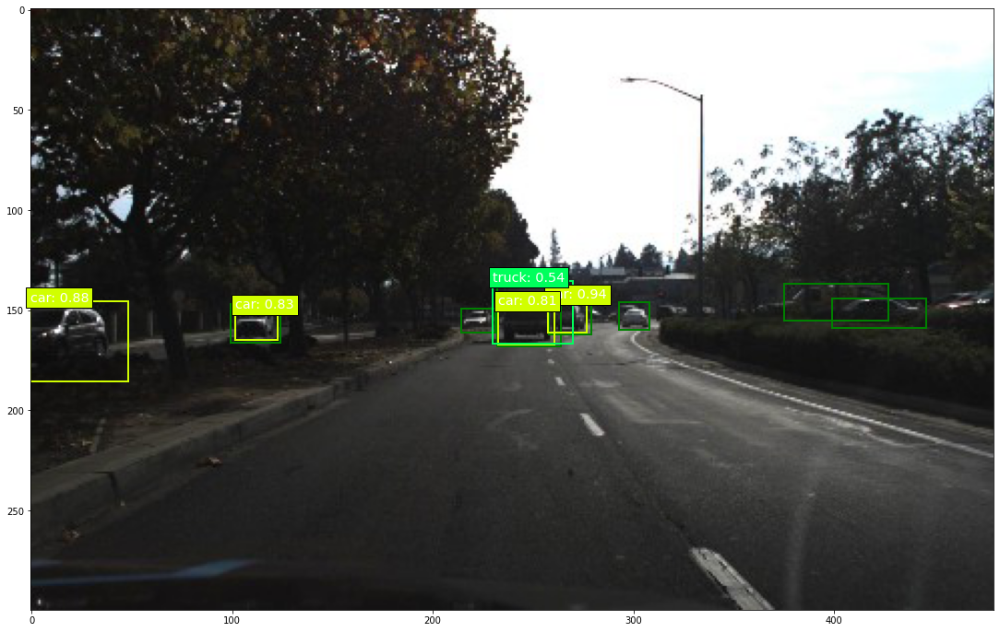

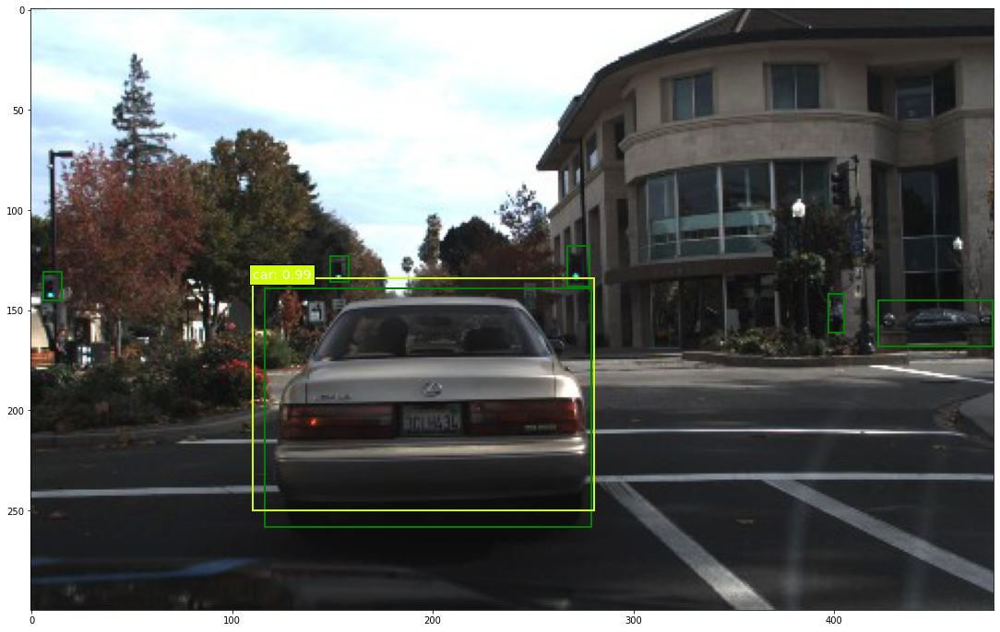

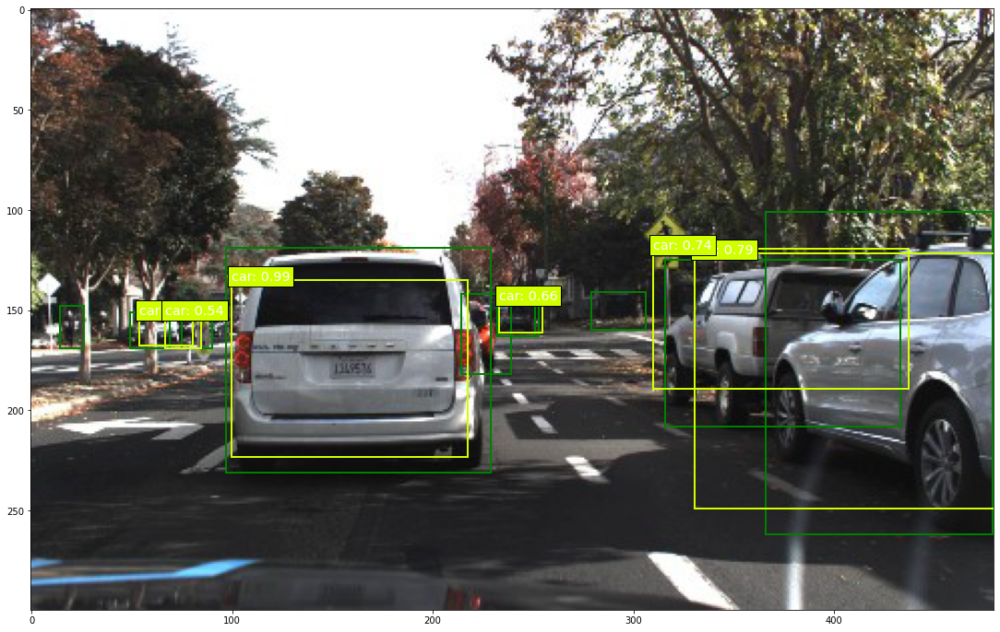

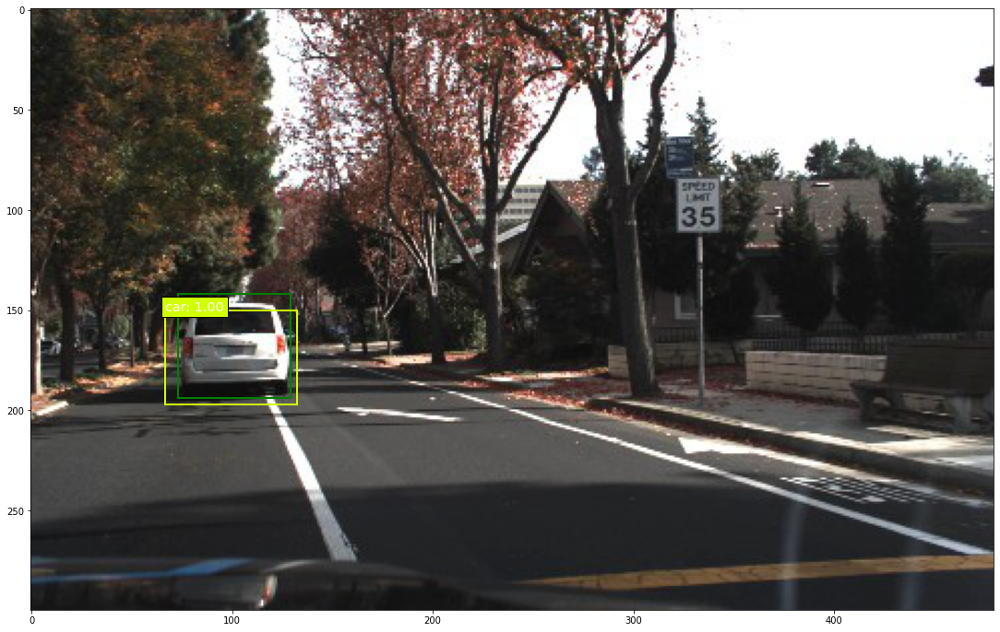

In [11]:
normalize_coords=True

for x in range(30):
  # 2: Generate samples
  batch_images, batch_labels, batch_filenames = next(predict_generator)
  i = 0 # Which batch item to look at
  print("Image:", batch_filenames[i])
  print()
  print("Ground truth boxes:\n")
  print(batch_labels[i])
  y_pred = model.predict(batch_images)
  # 4: Decode the raw prediction `y_pred`

  y_pred_decoded = decode_detections(y_pred,
                                   confidence_thresh=0.5,
                                   iou_threshold=0.45,
                                   top_k=200,
                                   normalize_coords=normalize_coords,
                                   img_height=img_height,
                                   img_width=img_width)

  np.set_printoptions(precision=2, suppress=True, linewidth=90)
  print("Predicted boxes:\n")
  print('   class   conf xmin   ymin   xmax   ymax')
  print(y_pred_decoded[i])
  # 5: Draw the predicted boxes onto the image

  plt.figure(figsize=(20,12))
  plt.imshow(batch_images[i])

  current_axis = plt.gca()

  colors = plt.cm.hsv(np.linspace(0, 1, n_classes+1)).tolist() # Set the colors for the bounding boxes
  classes = ['background', 'car', 'truck', 'pedestrian', 'bicyclist', 'light'] # Just so we can print class names onto the image instead of IDs

  # Draw the ground truth boxes in green (omit the label for more clarity)
  for box in batch_labels[i]:
      xmin = box[1]
      ymin = box[2]
      xmax = box[3]
      ymax = box[4]
      label = '{}'.format(classes[int(box[0])])
      current_axis.add_patch(plt.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, color='green', fill=False, linewidth=2))  
      #current_axis.text(xmin, ymin, label, size='x-large', color='white', bbox={'facecolor':'green', 'alpha':1.0})

  # Draw the predicted boxes in blue
  for box in y_pred_decoded[i]:
      xmin = box[-4]
      ymin = box[-3]
      xmax = box[-2]
      ymax = box[-1]
      color = colors[int(box[0])]
      label = '{}: {:.2f}'.format(classes[int(box[0])], box[1])
      current_axis.add_patch(plt.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, color=color, fill=False, linewidth=2))  
      current_axis.text(xmin, ymin, label, size='x-large', color='white', bbox={'facecolor':color, 'alpha':1.0})